# Prereqiusite 

In [1]:
# Imports
from PIL import Image, ImageFilter
import cv2 as cv
import matplotlib.pyplot as plt
import numpy as np

# Pre-Processing (Resize, Colour convert, Noise Gen)

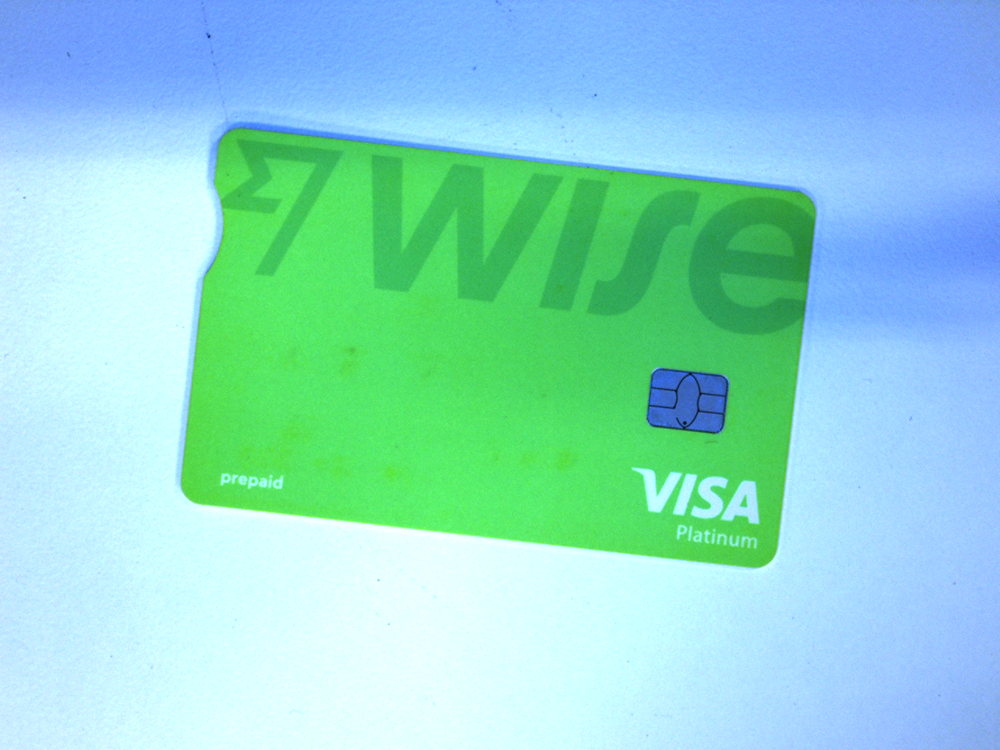

In [5]:
# Load the image (PILLOW)
filename = 'Lab 1 assets/G1_all.png'

with Image.open(filename) as img:
    img.load()

display(img)  # Display the image


Cropped:


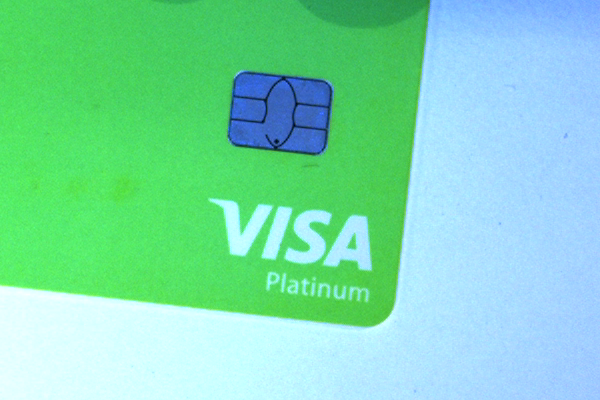

Cropped and resized:


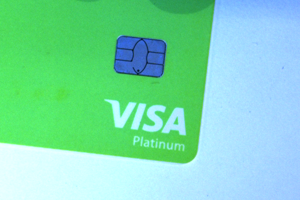

In [13]:
# Cropping the image (PILLOW)
print("Cropped:")
CropImg = img.crop((600, 400, 1200, 800))  # (left, top, right, bottom)
display(CropImg)

# Resizing the image (PILLOW)
print("Cropped and resized:")
CropLowRes = CropImg.resize((CropImg.width // 2, CropImg.height // 2))
display(CropLowRes)
# CropLowRes = CropImg.reduce(2)  # Alternative way to resize
# display(CropLowRes)

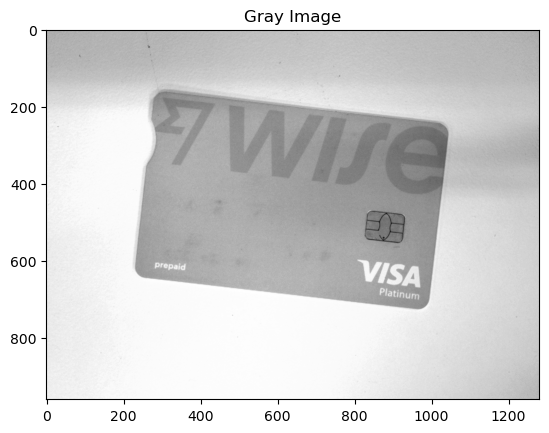

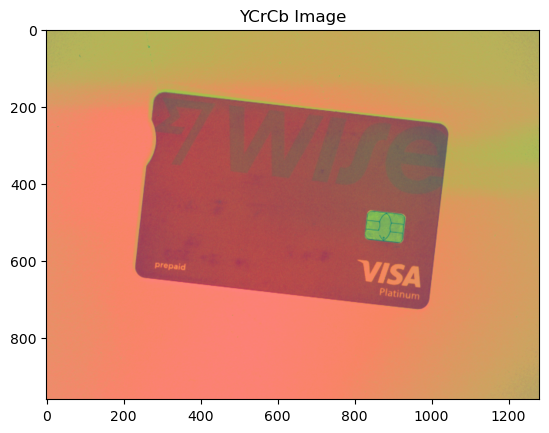

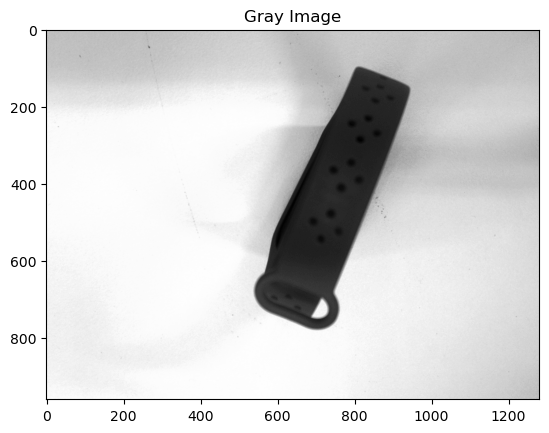

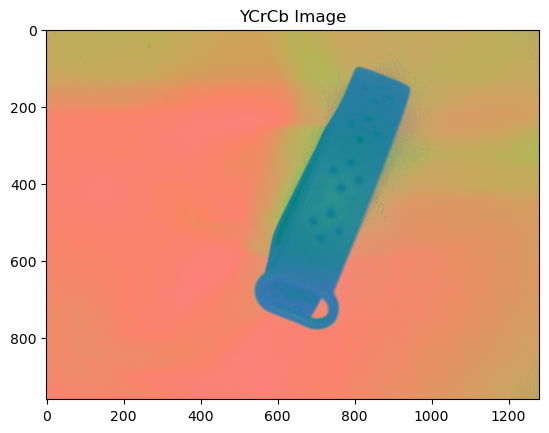

In [3]:
# Colorspace conversion (CV2)
img_cv = cv.imread(filename)

GrayImg = cv.cvtColor(img_cv, cv.COLOR_RGB2GRAY)
plt.title("Gray Image")
plt.imshow(GrayImg, cmap='gray')
plt.show()

YCrCbImg = cv.cvtColor(img_cv, cv.COLOR_RGB2YCrCb)
plt.title("YCrCb Image")
plt.imshow(YCrCbImg)
plt.show()

# Different images
img1 = cv.imread('Lab 1 assets/R1_all.png')

GrayImg = cv.cvtColor(img1, cv.COLOR_RGB2GRAY)
plt.title("Gray Image")
plt.imshow(GrayImg, cmap='gray')
plt.show()

YCrCbImg = cv.cvtColor(img1, cv.COLOR_RGB2YCrCb)
plt.title("YCrCb Image")
plt.imshow(YCrCbImg)
plt.show()

Gaussian noise:


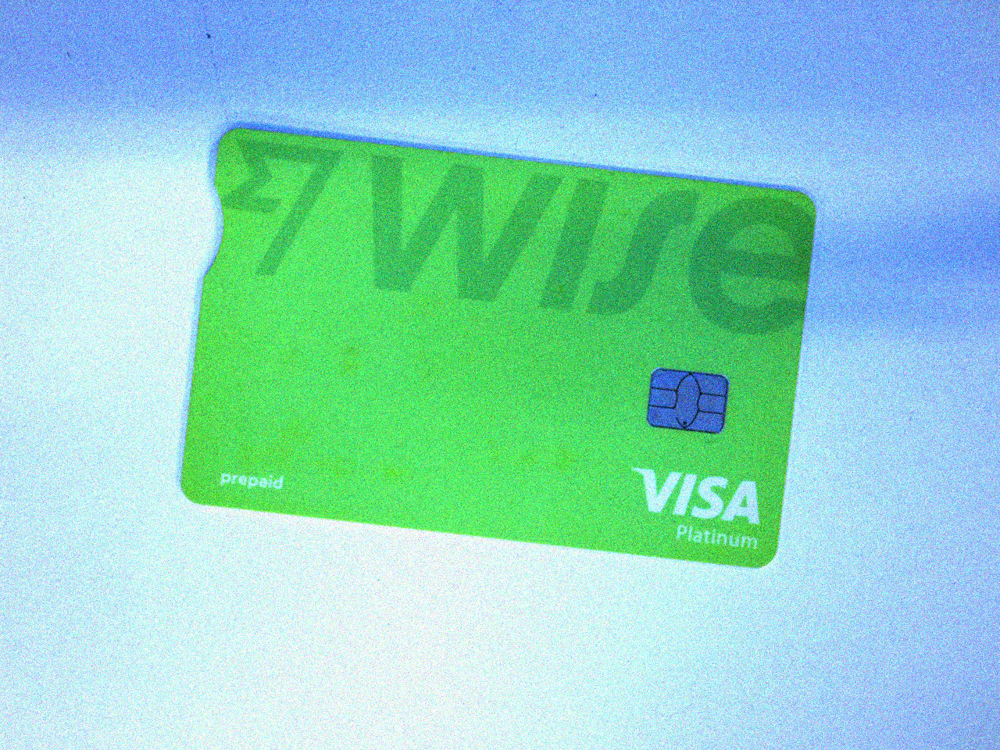

Salt and pepper noise:


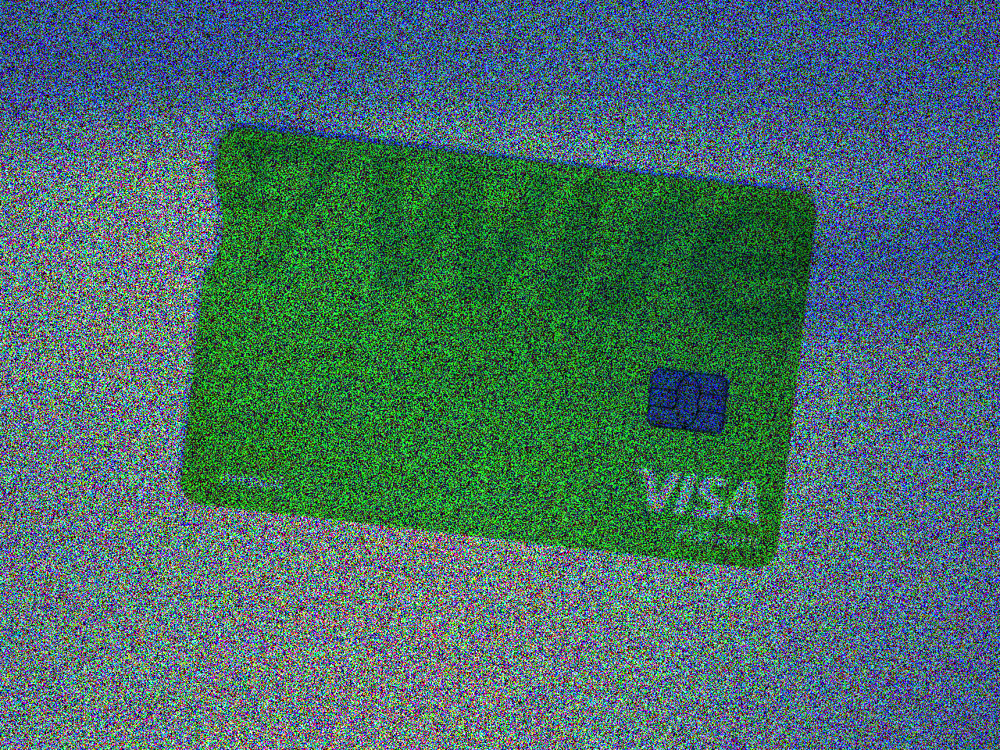

In [20]:
# Noise generation (NumPy)
img_array = np.array(img)

# Gaussian noise
gaussian_noise = np.random.normal(0, 25, img_array.shape)  # Mean, std, shape

# Salt and pepper noise
salt_pepper = np.random.randint(0, 2, img_array.shape)  # '0 ~ 2' makes either 0 or 1

# Apply noise to the image
gaussian_img_array = img_array + gaussian_noise
salt_pepper_img_array = img_array * salt_pepper
gaussian_img_array = np.clip(gaussian_img_array, 0, 255).astype(np.uint8)       # Clip the values to 0~255
salt_pepper_img_array = np.clip(salt_pepper_img_array, 0, 255).astype(np.uint8) # Clip the values to 0~255

# Display the images
gaussian_img = Image.fromarray(gaussian_img_array)
salt_pepper_img = Image.fromarray(salt_pepper_img_array)

print("Gaussian noise:")
display(gaussian_img)
print("Salt and pepper noise:")
display(salt_pepper_img)

# Morphological Operations (Erosion, Dilation)

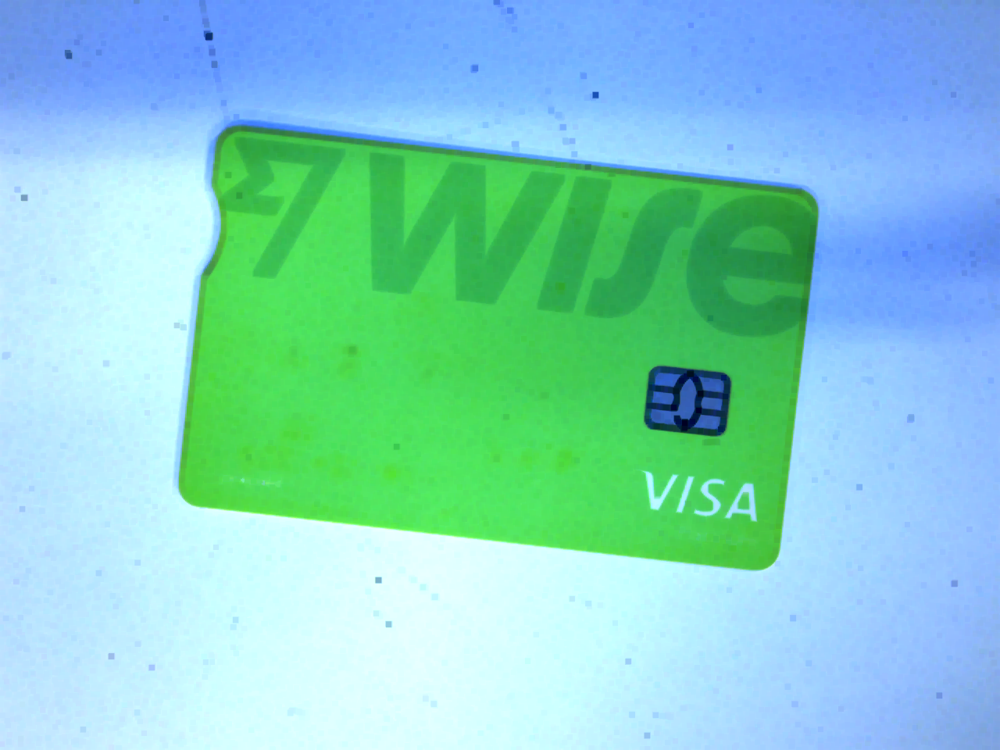

In [9]:
# Erosion
filename = 'Lab 1 assets/G1_all.png'  # Later repeat for Mix_all.png & G1_NG.jpg

with Image.open(filename) as img:
    img.load()

for i in range(3):  # Apply erosion 3 times
    img = img.filter(ImageFilter.MinFilter(3))

display(img)

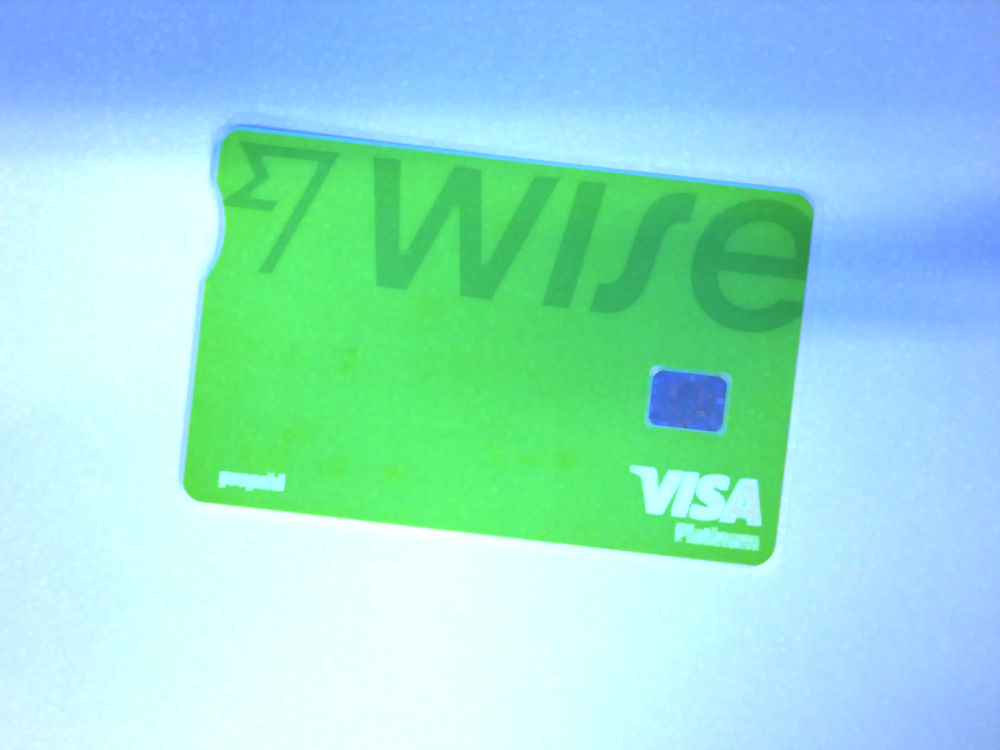

In [24]:
# Dilation
filename = 'Lab 1 assets/G1_all.png'  # Later repeat for Mix_all.png

with Image.open(filename) as img:
    img.load()

for i in range(3):  # Apply dialation 3 times
    img = img.filter(ImageFilter.MaxFilter(3))

display(img)

# Filters (Gaussian, Median, Mean)

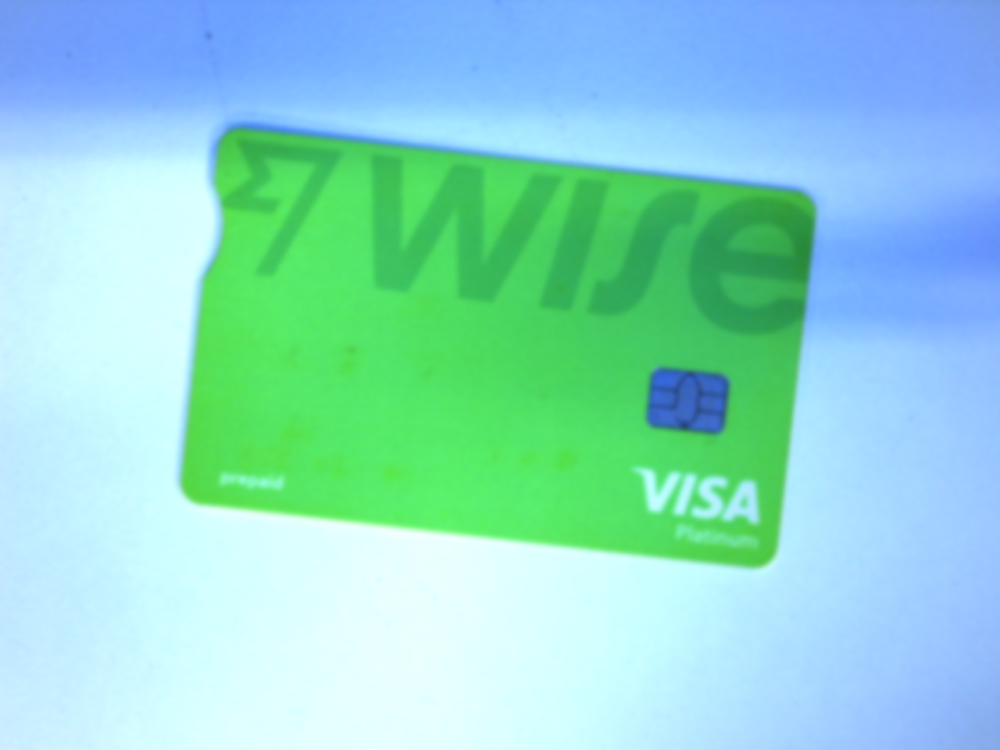

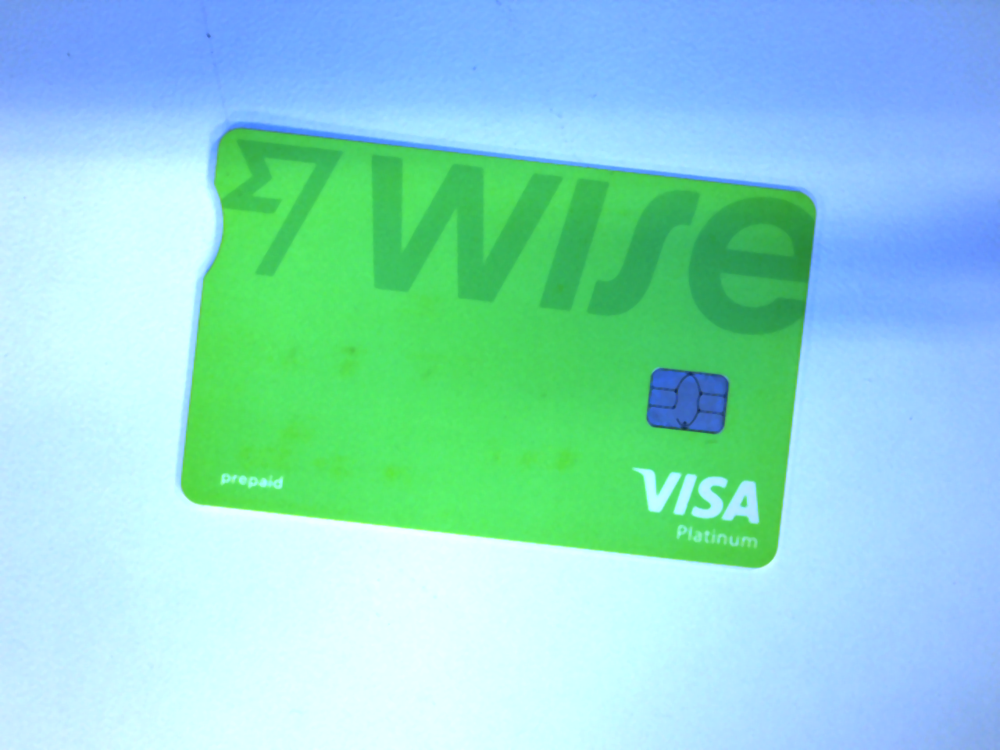

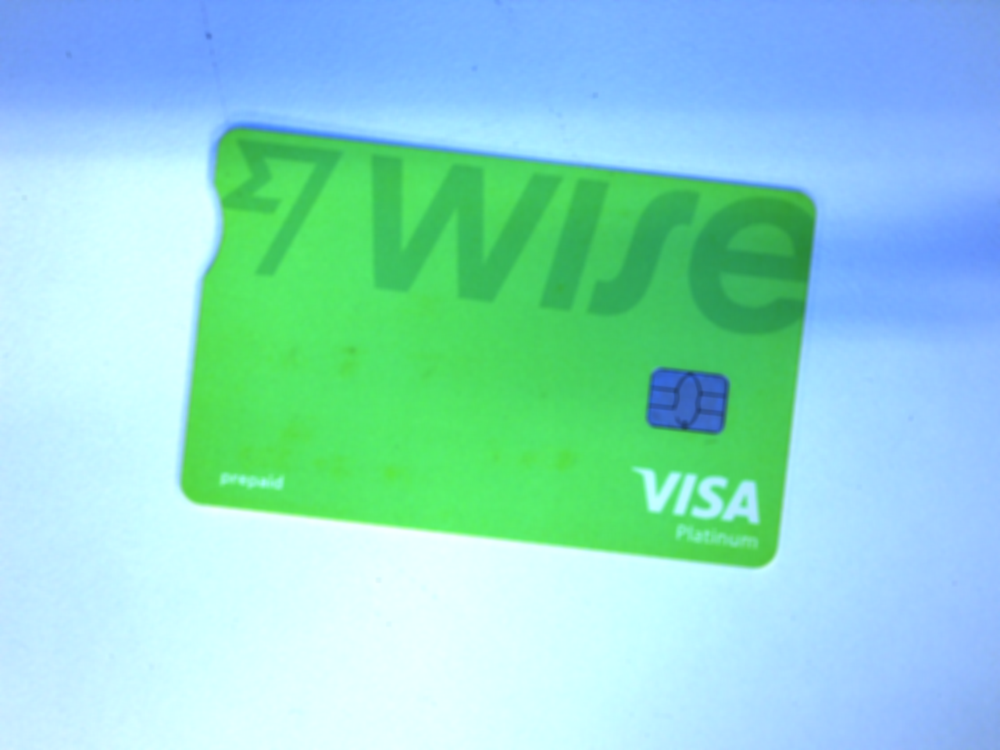

In [15]:
# Gaussian 
filename = 'Lab 1 assets/G1_all.png'

with Image.open(filename) as img:
    img.load()

display(img.filter(ImageFilter.GaussianBlur(3)))

# Median
display(img.filter(ImageFilter.MedianFilter(5)))

# Mean AKA Box filter
display(img.filter(ImageFilter.BoxBlur(3)))

# Edge Detection

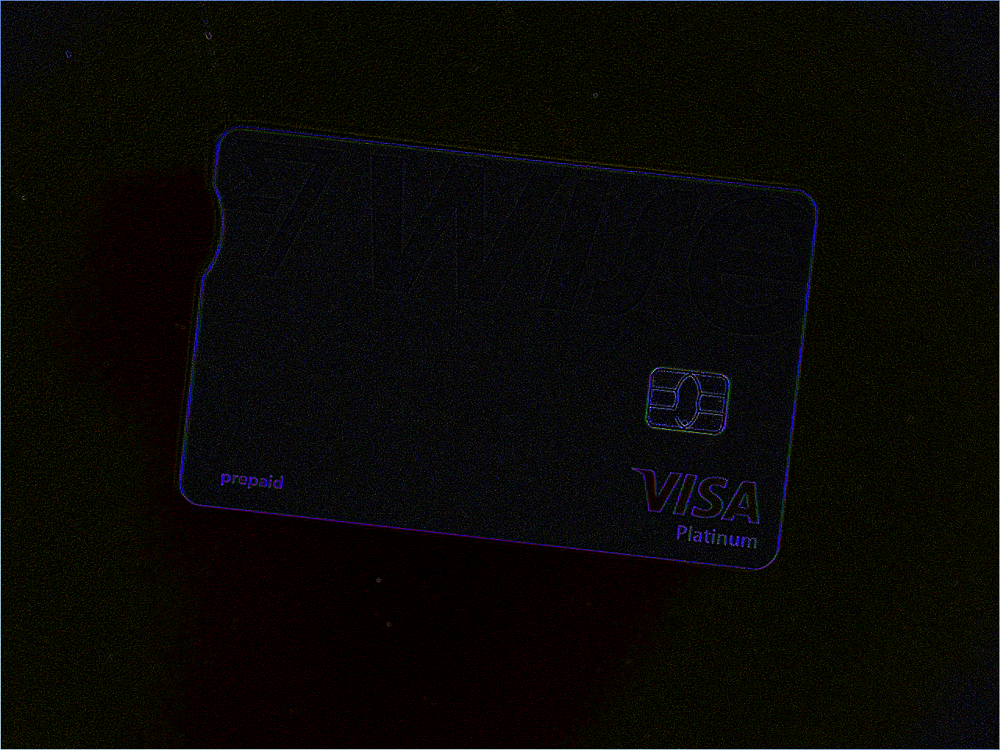

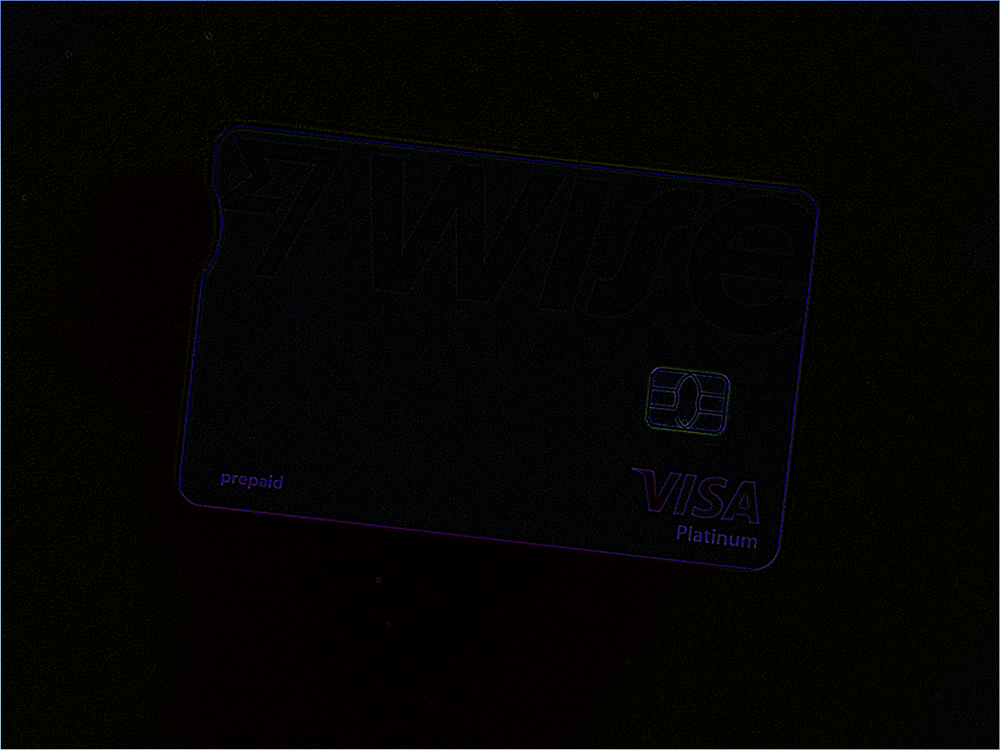

In [19]:
# Edge detection
filename = 'Lab 1 assets/G1_all.png'  # Do for all picture, show the difference in clarity

with Image.open(filename) as img:
    img.load()

display(img.filter(ImageFilter.FIND_EDGES))

# Smooth then edge detection
display(img.filter(ImageFilter.SMOOTH).filter(ImageFilter.FIND_EDGES))

# Histogram Equalization

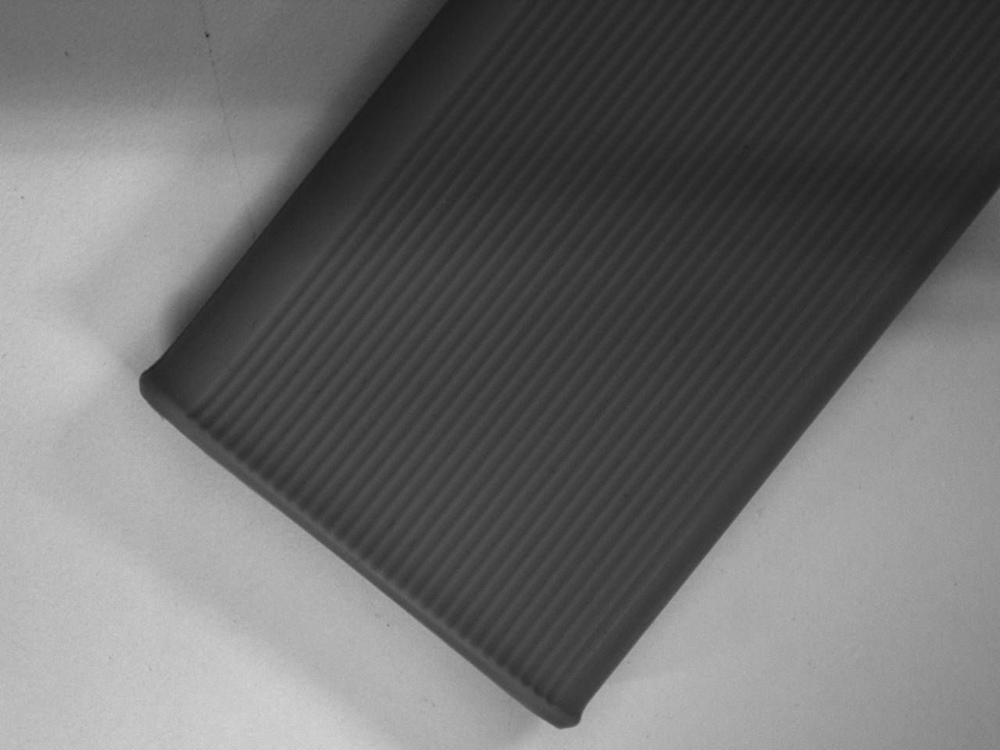

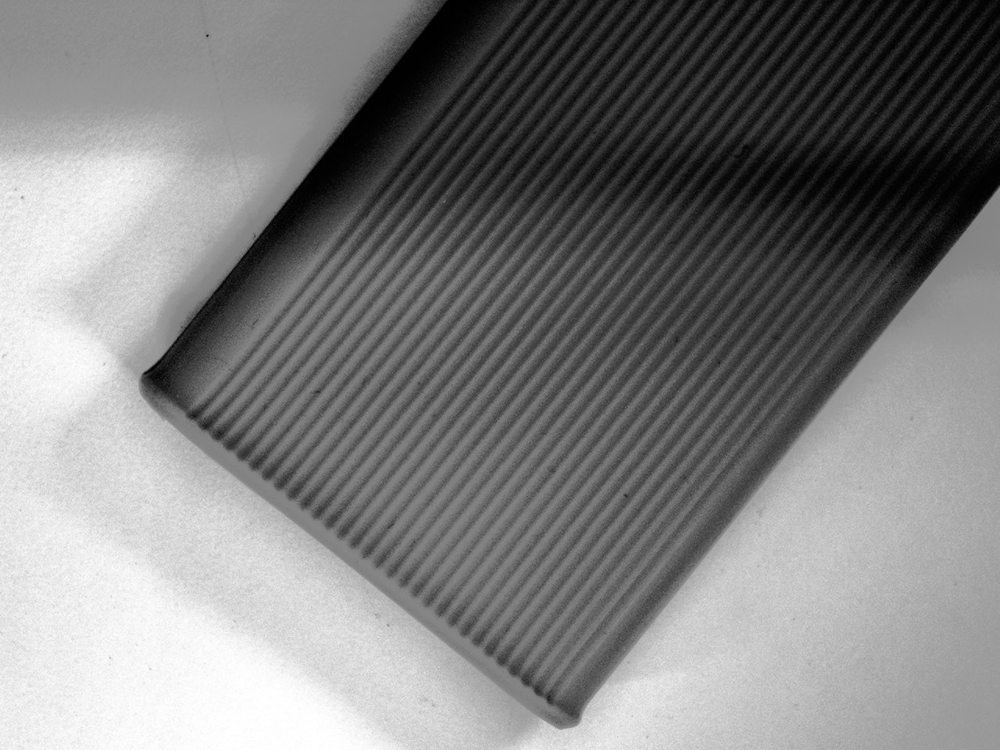

(array([ 1349.,  4326.,  3860.,  3113.,  4695.,  7278.,     0.,  9068.,
            0., 11306.,     0.,     0., 14099.,     0.,     0.,     0.,
        17791.,     0.,     0.,     0., 20716.,     0.,     0.,     0.,
            0., 23866.,     0.,     0.,     0., 20217.,     0.,     0.,
            0., 17865.,     0.,     0.,     0., 16945.,     0.,     0.,
        17879.,     0.,     0.,     0.,     0., 22421.,     0.,     0.,
            0., 18572.,     0.,     0.,     0., 18501.,     0.,     0.,
        15861.,     0.,     0., 13158.,     0.,     0., 13918.,     0.,
        13303.,     0.,     0., 14963.,     0.,     0.,     0., 15302.,
            0.,     0., 14805.,     0.,     0., 17067.,     0.,     0.,
            0., 17951.,     0.,     0.,     0., 20769.,     0.,     0.,
            0., 16752.,     0.,     0.,     0., 20058.,     0.,     0.,
        16344.,     0.,     0.,     0., 17329.,     0.,     0.,     0.,
        18194.,     0.,     0., 16050.,     0.,     0., 15318., 

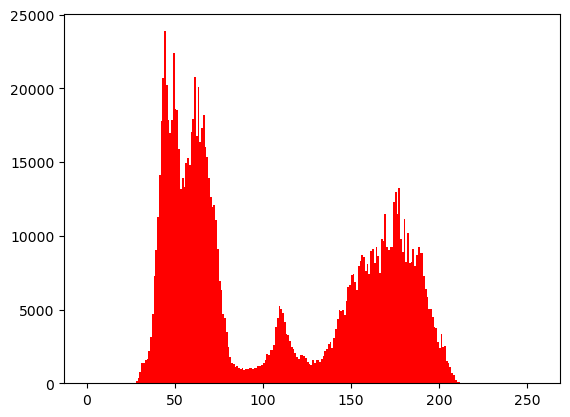

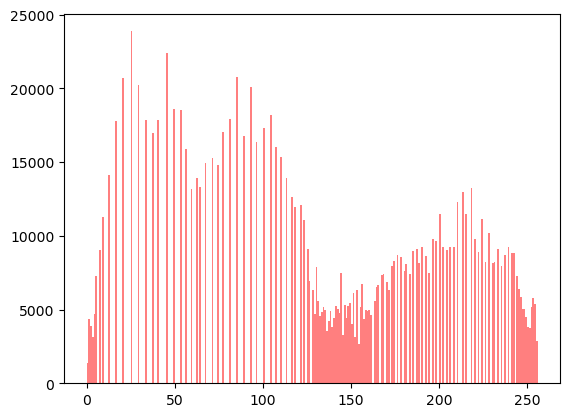

In [14]:
# Histogram equalization (To enhance contrast)
filename = 'Lab 1 assets/B1_all.png'

with Image.open(filename) as img:
    img.load()

img_gray = img.convert('L')  # Convert to grayscale
display(img_gray)

img_array = np.array(img_gray)  # Convert to numpy array
img_eq = cv.equalizeHist(img_array)  # Equalize the histogram
img_eq = Image.fromarray(img_eq)  # Convert back to PIL image

display(img_eq)

# Histogram graph
plt.figure()
plt.hist(img_array.flatten(), 256, [0, 256], color='r')  # Original
plt.figure()
plt.hist(np.array(img_eq).flatten(), 256, [0, 256], color='r', alpha=0.5)  # Equalized

# Hough Transforms

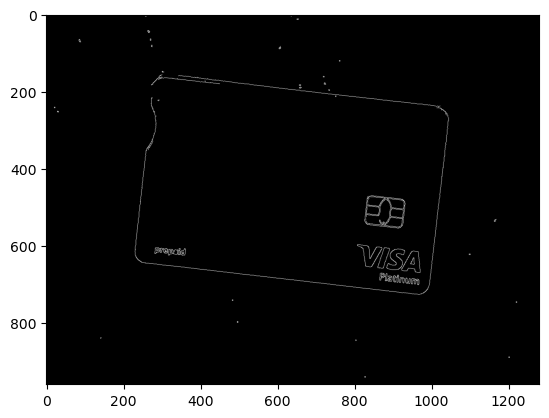

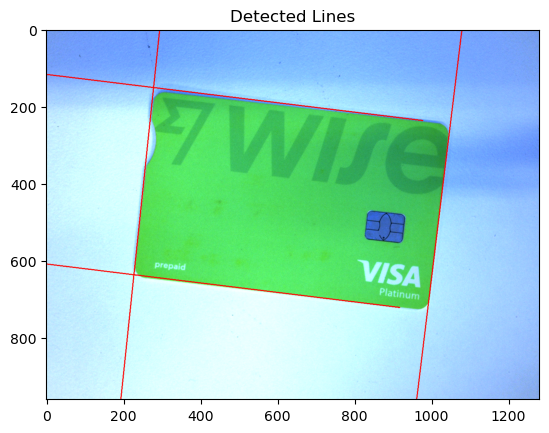

In [23]:
# Hough lines transform (CV2)
filename = 'Lab 1 assets/G1_all.png'

img = cv.imread(filename)
gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
edges = cv.Canny(gray, 50, 150)  # Edge detection
plt.imshow(edges, cmap='gray')
plt.show()
lines = cv.HoughLines(edges, 1, np.pi/180, 145)  # Hough transform based on the edges, threshold = 145 (G1), 155 (Mix)

if lines is not None:  # Draw the red lines on the image
    for line in lines:
        rho, theta = line[0]
        a = np.cos(theta)
        b = np.sin(theta)
        x0 = a * rho
        y0 = b * rho
        x1 = int(x0 + 1000 * (-b))
        y1 = int(y0 + 1000 * (a))
        x2 = int(x0 - 1000 * (-b))
        y2 = int(y0 - 1000 * (a))

        cv.line(img, (x1, y1), (x2, y2), (0, 0, 255), 2)

plt.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB))  # Display the image with the lines drawn
plt.title('Detected Lines')
plt.show()

# Other Morphological Operations (Closing, Opening)

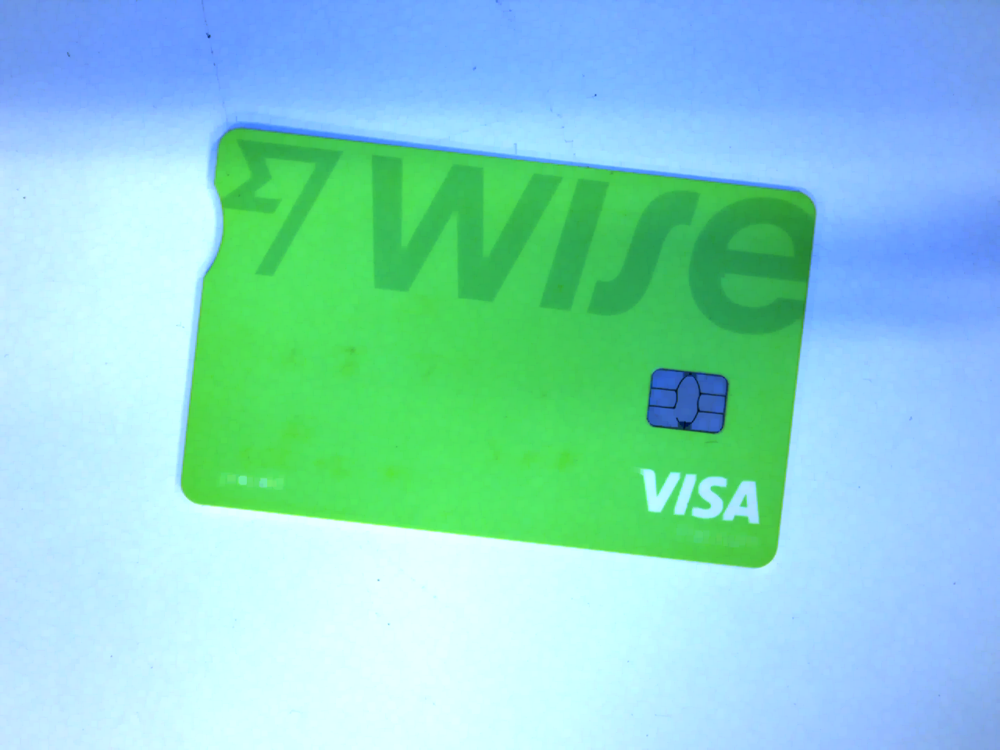

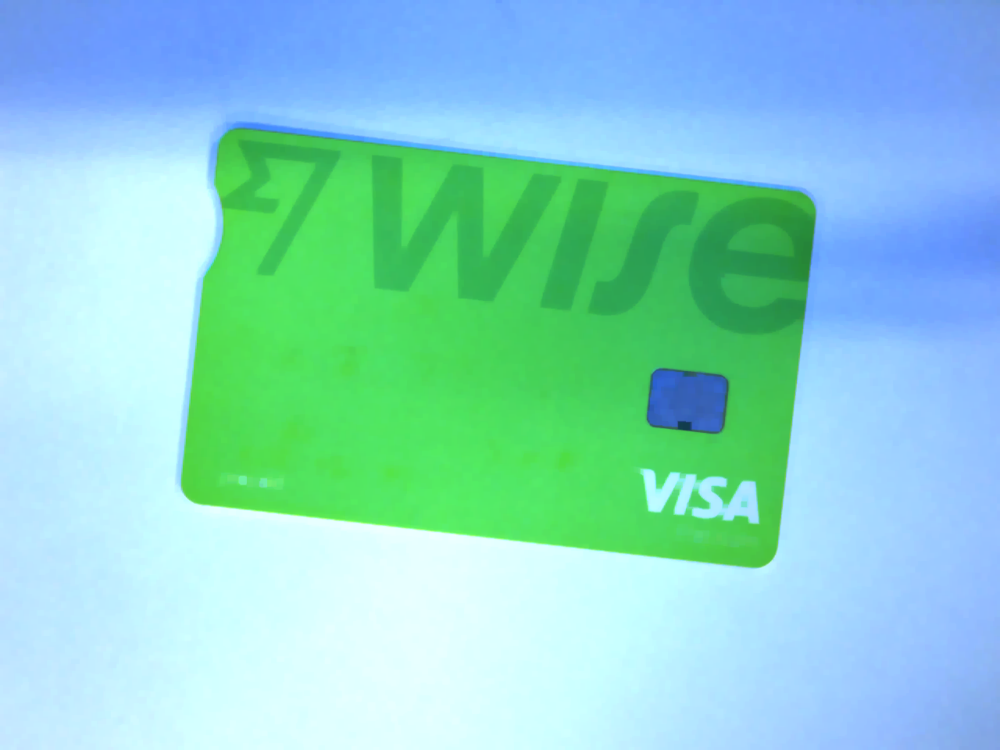

In [68]:
# Closing morphological operation - Erosion followed by dilation (PILLOW)
filename = 'Lab 1 assets/G1_all.png'

with Image.open(filename) as img:
    img.load()

for i in range(3):  # Apply erosion 3 times
    img = img.filter(ImageFilter.MinFilter(3))

for i in range(3):  # Apply dilation 3 times
    img = img.filter(ImageFilter.MaxFilter(3))

display(img)

# Opening morphological operation - Dilation followed by erosion (PILLOW)
for i in range(3):  # Apply dilation 3 times
    img = img.filter(ImageFilter.MaxFilter(3))

for i in range(3):  # Apply erosion 3 times
    img = img.filter(ImageFilter.MinFilter(3))

display(img)
